In [1]:
import json
import numpy as np
import pandas as pd
import pyproj
import plotly.graph_objects as go

import parking_utils as pu
import os

os.environ["USE_PYGEOS"] = "0"
import geopandas as gpd
from tqdm import tqdm
import matplotlib.pyplot as plt

# load files

In [2]:
# load vehicle detections
car_triangulations_df = gpd.read_file(
    "/home/sf_afn/Downloads/univrses_data/parked_car_triangulations_2023_04_24.csv"
)


In [3]:
# Load the parking segments
with open("/home/sf_afn//Downloads/univrses_data/permitted_parking.json") as user_file:
    parking_json = json.load(user_file)

permitted_parking_gdf = gpd.read_file(
    "/home/sf_afn/Downloads/univrses_data/permitted_parking.json"
)

In [4]:
car_triangulations_df.head()


,Unnamed: 0,id,x,y,z,first_timestamp,last_timestamp,latitude,longitude,first_unix_timestamp,last_unix_timestamp,geometry
0,0,2,64.18195,43.94798,49.457394,622954985344947,622955983380676,59.305840999794086,18.01004647522499,1682336992.7773957,1682336993.7754316,None
1,1,3,82.989784,48.38991,49.215767,622956815077135,622957646773541,59.30588087007252,18.01037664291513,1682336994.607128,1682336995.4388244,None
2,2,7,201.27101,67.326744,47.511715,622968226094195,622969723285658,59.306050819217724,18.012453055048027,1682337006.018145,1682337007.5153365,None
3,3,8,208.23976,68.62833,47.38071,622969390607117,622970388642794,59.30606249969557,18.012575391408074,1682337007.182658,1682337008.1806936,None
4,4,9,217.61241,71.44035,47.218464,622970055964252,622971386812428,59.30608773743127,18.012739929417272,1682337007.848015,1682337009.1788633,None


In [5]:
permitted_parking_gdf


,id,FID,FEATURE_OBJECT_ID,FEATURE_VERSION_ID,EXTENT_NO,VALID_FROM,VALID_TO,VEHICLE,START_TIME,END_TIME,...,CITY_DISTRICT,PARKING_DISTRICT,OTHER_INFO,VF_METER,VF_PLATSER,VF_PLATS_TYP,ADDRESS,RDT_URL,PARKING_RATE,geometry
0,LTFR_P_TILLATEN.44817868,44817868,13742836,1,5,2018-01-29 23:00:00+00:00,NaT,fordon,1600.0,800.0,...,Bagarmossen,Bagarmossen,Servicetid fredag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Lagavägen 2,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (157288.172 6573698.371, 157287.080..."
1,LTFR_P_TILLATEN.44817869,44817869,13750219,1,1,2017-10-03 22:00:00+00:00,NaT,rörelsehindrade,NaN,NaN,...,Södermalm,Södermalm,NaN,NaN,3.0,Reserverad p-plats rörelsehindrad,Heleneborgsgatan 4A,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (152484.638 6578284.974, 152483.502..."
2,LTFR_P_TILLATEN.44817870,44817870,13751474,1,1,2017-10-24 22:00:00+00:00,NaT,rörelsehindrade,NaN,NaN,...,Vasastaden,Vasastan,NaN,6.0,NaN,Reserverad p-plats rörelsehindrad,Observatoriegatan 20,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (152736.834 6580534.810, 152731.302..."
3,LTFR_P_TILLATEN.44817871,44817871,13718834,1,1,2018-01-29 23:00:00+00:00,NaT,fordon,NaN,NaN,...,Bagarmossen,Bagarmossen,Servicetid tisdag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Letstigen 46 - Letstigen 56,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (158341.006 6573198.838, 158366.896..."
4,LTFR_P_TILLATEN.44817872,44817872,13718834,1,1,2018-01-29 23:00:00+00:00,NaT,fordon,1600.0,800.0,...,Bagarmossen,Bagarmossen,Servicetid tisdag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Letstigen 46 - Letstigen 56,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (158341.006 6573198.838, 158366.896..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18134,LTFR_P_TILLATEN.44817181,44817181,13025060,1,1,2017-09-20 22:00:00+00:00,NaT,fordon,600.0,0.0,...,Södermalm,Södermalm,Servicetid fredag 00:00-06:00,NaN,NaN,P-avgift endast besök,Götgatan 82 - 88,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,taxa 2: 31 kr/tim vardagar 7-21 och dag före h...,"LINESTRING (154246.742 6577360.531, 154263.785..."
18135,LTFR_P_TILLATEN.44817182,44817182,12920095,1,1,2017-09-18 22:00:00+00:00,NaT,fordon,1400.0,900.0,...,Södermalm,Södermalm,Servicetid onsdag 09:00-14:00,NaN,NaN,"P Avgift, boende",Mosebacke Torg 4,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (154193.563 6578151.364, 154194.802..."
18136,LTFR_P_TILLATEN.44817183,44817183,13001611,1,1,2017-10-03 22:00:00+00:00,NaT,fordon,600.0,0.0,...,Södermalm,Södermalm,Servicetid onsdag 00:00-06:00,NaN,NaN,"P Avgift, boende",Timmermansgatan 44,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (153509.180 6577746.800, 153510.968..."
18137,LTFR_P_TILLATEN.44817184,44817184,13002374,1,1,2018-02-28 23:00:00+00:00,NaT,fordon,NaN,NaN,...,Mariehäll,Riksby,Servicetid onsdag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Gårdsfogdevägen 34 - Hagelstavägen 10,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (147140.646 6582555.177, 147111.889..."


In [6]:
permitted_parking_gdf["xy"] = permitted_parking_gdf["geometry"].apply(
    lambda row: row.xy
)

In [7]:
permitted_parking_gdf["xy"].iloc[10]

(array('d', [158065.928693, 158066.555098, 158095.755202, 158095.772516, 158138.292692]),
 array('d', [6573071.147341, 6573071.274821, 6573077.925229, 6573077.929137, 6573087.437235]))

In [8]:
permitted_parking_gdf["xy"].iloc[10][0][0], permitted_parking_gdf["xy"].iloc[10][0][-1]

(158065.928693, 158138.292692)

In [9]:
permitted_parking_gdf["geom_simple"] = permitted_parking_gdf["xy"].apply(
    lambda row: [[row[0][0], row[0][-1]], [row[1][0], row[1][-1]]]
)

In [10]:
permitted_parking_gdf


,id,FID,FEATURE_OBJECT_ID,FEATURE_VERSION_ID,EXTENT_NO,VALID_FROM,VALID_TO,VEHICLE,START_TIME,END_TIME,...,OTHER_INFO,VF_METER,VF_PLATSER,VF_PLATS_TYP,ADDRESS,RDT_URL,PARKING_RATE,geometry,xy,geom_simple
0,LTFR_P_TILLATEN.44817868,44817868,13742836,1,5,2018-01-29 23:00:00+00:00,NaT,fordon,1600.0,800.0,...,Servicetid fredag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Lagavägen 2,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (157288.172 6573698.371, 157287.080...","([157288.172185, 157287.080218, 157287.07885, ...","[[157288.172185, 157268.464318], [6573698.3706..."
1,LTFR_P_TILLATEN.44817869,44817869,13750219,1,1,2017-10-03 22:00:00+00:00,NaT,rörelsehindrade,NaN,NaN,...,NaN,NaN,3.0,Reserverad p-plats rörelsehindrad,Heleneborgsgatan 4A,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (152484.638 6578284.974, 152483.502...","([152484.637745, 152483.502093], [6578284.9735...","[[152484.637745, 152483.502093], [6578284.9735..."
2,LTFR_P_TILLATEN.44817870,44817870,13751474,1,1,2017-10-24 22:00:00+00:00,NaT,rörelsehindrade,NaN,NaN,...,NaN,6.0,NaN,Reserverad p-plats rörelsehindrad,Observatoriegatan 20,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (152736.834 6580534.810, 152731.302...","([152736.834188, 152731.301517], [6580534.8103...","[[152736.834188, 152731.301517], [6580534.8103..."
3,LTFR_P_TILLATEN.44817871,44817871,13718834,1,1,2018-01-29 23:00:00+00:00,NaT,fordon,NaN,NaN,...,Servicetid tisdag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Letstigen 46 - Letstigen 56,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (158341.006 6573198.838, 158366.896...","([158341.005664, 158366.896226, 158371.440507,...","[[158341.005664, 158374.812032], [6573198.8383..."
4,LTFR_P_TILLATEN.44817872,44817872,13718834,1,1,2018-01-29 23:00:00+00:00,NaT,fordon,1600.0,800.0,...,Servicetid tisdag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Letstigen 46 - Letstigen 56,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (158341.006 6573198.838, 158366.896...","([158341.005664, 158366.896226, 158371.440507,...","[[158341.005664, 158374.812032], [6573198.8383..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18134,LTFR_P_TILLATEN.44817181,44817181,13025060,1,1,2017-09-20 22:00:00+00:00,NaT,fordon,600.0,0.0,...,Servicetid fredag 00:00-06:00,NaN,NaN,P-avgift endast besök,Götgatan 82 - 88,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,taxa 2: 31 kr/tim vardagar 7-21 och dag före h...,"LINESTRING (154246.742 6577360.531, 154263.785...","([154246.741998, 154263.785183], [6577360.5312...","[[154246.741998, 154263.785183], [6577360.5312..."
18135,LTFR_P_TILLATEN.44817182,44817182,12920095,1,1,2017-09-18 22:00:00+00:00,NaT,fordon,1400.0,900.0,...,Servicetid onsdag 09:00-14:00,NaN,NaN,"P Avgift, boende",Mosebacke Torg 4,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (154193.563 6578151.364, 154194.802...","([154193.562663, 154194.802372, 154195.347569,...","[[154193.562663, 154200.037125], [6578151.3642..."
18136,LTFR_P_TILLATEN.44817183,44817183,13001611,1,1,2017-10-03 22:00:00+00:00,NaT,fordon,600.0,0.0,...,Servicetid onsdag 00:00-06:00,NaN,NaN,"P Avgift, boende",Timmermansgatan 44,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (153509.180 6577746.800, 153510.968...","([153509.180455, 153510.967545], [6577746.8001...","[[153509.180455, 153510.967545], [6577746.8001..."
18137,LTFR_P_TILLATEN.44817184,44817184,13002374,1,1,2018-02-28 23:00:00+00:00,NaT,fordon,NaN,NaN,...,Servicetid onsdag 08:00-16:00 1/11 - 15/5,NaN,NaN,"P Avgift, boende",Gårdsfo

# Calculate parking count

In [11]:
# ----> 1. convert loaded df crs
car_triangulations_df = pu.convert_crs(car_triangulations_df)
detections = car_triangulations_df["xy_3011"][:]

# 2. Get nearby parkings from point
car_triangulations_df["nearby_parking_ids"] = car_triangulations_df.apply(
    lambda row: pu.parking_proximity(row["xy_3011"], parking_json, radius=20),
    axis=1,
)

In [12]:
car_tri_df = pu.filter_nearby_parking_idx(car_triangulations_df)

In [13]:
car_tri_df


,Unnamed: 0,id,x,y,z,first_timestamp,last_timestamp,latitude,longitude,first_unix_timestamp,last_unix_timestamp,geometry,x_3011,y_3011,xy_3011,nearby_parking_ids
8,8,31,1063.1616,274.3666,31.577951,623081999074153,623083163332620,59.30790804978032,18.027584401205537,1682337119.791125,1682337120.9553835,None,151571.244094,6.576970e+06,"[151571.24409353055, 6576969.686092908]","[7678, 13843]"
9,9,33,1068.8466,270.84064,31.303724,623082996993349,623083995029026,59.30787638422826,18.02768418832258,1682337120.7890441,1682337121.7870798,None,151576.929566,6.576966e+06,"[151576.92956560163, 6576966.160893947]","[7407, 7678, 7678, 13843, 13843]"
10,10,34,1072.9042,267.79724,31.32184,623083329671891,623084826725484,59.30784905449237,18.027755407442772,1682337121.1217227,1682337122.6187763,None,151580.987573,6.576963e+06,"[151580.98757305942, 6576963.118037125]","[7407, 7678, 7678, 13843, 13843]"
11,11,35,1066.7552,262.20648,31.614662,623083662350484,623085492082620,59.30779888389875,18.02764742961538,1682337121.4544013,1682337123.2841334,None,151574.839321,6.576958e+06,"[151574.8393214606, 6576957.5264539]","[7407, 7678, 7678, 13843, 13843]"
12,12,38,1090.1403,250.3974,31.119736,623087987171891,623089484107214,59.30769281857222,18.028057912177275,1682337125.7792227,1682337127.276158,None,151598.226003,6.576946e+06,"[151598.22600254626, 6576945.720504424]","[7407, 7407, 7678, 13843]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170,170,586,1060.9387,804.76404,22.497662,623598617184001,623599116201813,59.312669232172965,18.027547979878186,1682337636.4092348,1682337636.9082527,None,151568.950186,6.577500e+06,"[151568.95018619884, 6577500.0832392555]","[14173, 14206, 15397, 15397, 15397, 15398, 153..."
171,171,587,1060.4796,791.93646,22.582565,623598783523271,623599448880407,59.31255408504209,18.027539855952305,1682337636.5755742,1682337637.2409313,None,151568.492804,6.577487e+06,"[151568.49280353775, 6577487.255597696]","[14173, 14173, 14173, 14206, 14206, 14206, 153..."
172,172,588,1060.9501,802.43866,22.716976,623598783523271,623599814826813,59.31264835809702,18.02754816862609,1682337636.5755742,1682337637.6068776,None,151568.961898,6.577498e+06,"[151568.96189751846, 6577497.757860763]","[14173, 14206, 15397, 15397, 15397, 15398, 153..."
173,173,589,1043.4265,787.79224,22.66649,623600480184001,623601977329535,59.31251692640001,18.027240414815374,1682337638.272235,1682337639.7693803,None,151551.440258,6.577483e+06,"[151551.44025823617, 6577483.109094617]","[13442, 13442, 13442, 13442, 13442, 14173, 141..."


In [14]:
filtered_car_tri_df = pu.locate_closest_parking_idx(car_tri_df, parking_json)

  0%|          | 0/117 [00:00<?, ?it/s]/home/sf_afn/usr_sa/anaconda3/envs/prkng_v2_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/sf_afn/usr_sa/anaconda3/envs/prkng_v2_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
100%|██████████| 117/117 [00:00<00:00, 3018.80it/s]


In [15]:
filtered_car_tri_df


,Unnamed: 0,id,x,y,z,first_timestamp,last_timestamp,latitude,longitude,first_unix_timestamp,last_unix_timestamp,geometry,x_3011,y_3011,xy_3011,nearby_parking_ids,closest_parking_id,all_close_parking_id
8,8,31,1063.1616,274.3666,31.577951,623081999074153,623083163332620,59.30790804978032,18.027584401205537,1682337119.791125,1682337120.9553835,None,151571.244094,6.576970e+06,"[151571.24409353055, 6576969.686092908]","[7678, 13843]",13843.0,"{7678: [15.120528536130461], 13843: [6.6374417..."
9,9,33,1068.8466,270.84064,31.303724,623082996993349,623083995029026,59.30787638422826,18.02768418832258,1682337120.7890441,1682337121.7870798,None,151576.929566,6.576966e+06,"[151576.92956560163, 6576966.160893947]","[7407, 7678, 7678, 13843, 13843]",13843.0,"[{7407: [19.262083874226448], 7678: [13.786552..."
10,10,34,1072.9042,267.79724,31.32184,623083329671891,623084826725484,59.30784905449237,18.027755407442772,1682337121.1217227,1682337122.6187763,None,151580.987573,6.576963e+06,"[151580.98757305942, 6576963.118037125]","[7407, 7678, 7678, 13843, 13843]",13843.0,"[{7407: [16.115616206199594], 7678: [13.756911..."
11,11,35,1066.7552,262.20648,31.614662,623083662350484,623085492082620,59.30779888389875,18.02764742961538,1682337121.4544013,1682337123.2841334,None,151574.839321,6.576958e+06,"[151574.8393214606, 6576957.5264539]","[7407, 7678, 7678, 13843, 13843]",13843.0,"[{7407: [11.447294796960579], 7678: [5.5980997..."
12,12,38,1090.1403,250.3974,31.119736,623087987171891,623089484107214,59.30769281857222,18.028057912177275,1682337125.7792227,1682337127.276158,None,151598.226003,6.576946e+06,"[151598.22600254626, 6576945.720504424]","[7407, 7407, 7678, 13843]",7407.0,"[{7407: [10.183149332229677], 7678: [19.165802..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170,170,586,1060.9387,804.76404,22.497662,623598617184001,623599116201813,59.312669232172965,18.027547979878186,1682337636.4092348,1682337636.9082527,None,151568.950186,6.577500e+06,"[151568.95018619884, 6577500.0832392555]","[14173, 14206, 15397, 15397, 15397, 15398, 153...",15397.0,"[{14173: [2.117781095374729], 14206: [2.117781..."
171,171,587,1060.4796,791.93646,22.582565,623598783523271,623599448880407,59.31255408504209,18.027539855952305,1682337636.5755742,1682337637.2409313,None,151568.492804,6.577487e+06,"[151568.49280353775, 6577487.255597696]","[14173, 14173, 14173, 14206, 14206, 14206, 153...",14173.0,"[{14173: [12.384150109536023], 14206: [12.3841..."
172,172,588,1060.9501,802.43866,22.716976,623598783523271,623599814826813,59.31264835809702,18.02754816862609,1682337636.5755742,1682337637.6068776,None,151568.961898,6.577498e+06,"[151568.96189751846, 6577497.757860763]","[14173, 14206, 15397, 15397, 15397, 15398, 153...",14173.0,"[{14173: [4.032919745741063], 14206: [4.032919..."
173,173,589,1043.4265,787.79224,22.66649,623600480184001,623601977329535,59.31251692640001,18.027240414815374,1682337638.272235,1682337639.7693803,None,151551.440258,6.577483e+06,"[151551.44025823617, 6577483.109094617]","[13442, 13442, 13442, 13442, 13442, 14173, 141...",14173.0,"[{13442: [15.291706474867084], 14173: [6.04416..."


In [16]:
filtered_car_tri_df["closest_parking_id"] = filtered_car_tri_df.apply(
    lambda r: int(r["closest_parking_id"]), axis=1
)

/home/sf_afn/usr_sa/anaconda3/envs/prkng_v2_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [17]:
def get_true_parking_id(idx, parking_json):
    return parking_json["features"][idx]["properties"]["FID"]

In [18]:
filtered_car_tri_df["FID"] = filtered_car_tri_df.apply(
    lambda r: get_true_parking_id(r["closest_parking_id"], parking_json), axis=1
)

/home/sf_afn/usr_sa/anaconda3/envs/prkng_v2_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [19]:
filtered_car_tri_df.reset_index(inplace=True)


In [20]:
filtered_car_tri_df.set_index("FID", inplace=True)

In [21]:
# ---> calc count for each parking
filtered_car_tri_df["parking_count"] = filtered_car_tri_df.groupby("FID").count()[
    "xy_3011"
]

/home/sf_afn/usr_sa/anaconda3/envs/prkng_v2_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [22]:
filtered_car_tri_df[["closest_parking_id", "parking_count"]].iloc[0]

closest_parking_id    13843
parking_count             5
Name: 44813550, dtype: int64

In [23]:
filtered_car_tri_df["closest_parking_geom"] = filtered_car_tri_df.apply(
    lambda row: pu.parking_line_at_index(parking_json, row["closest_parking_id"]),
    axis=1,
)

/home/sf_afn/usr_sa/anaconda3/envs/prkng_v2_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [24]:
parking_json


{'type': 'FeatureCollection',
 'crs': {'type': 'name', 'properties': {'name': 'urn:ogc:def:crs:EPSG::3011'}},
 'features': [{'type': 'Feature',
   'properties': {'id': 'LTFR_P_TILLATEN.44817868',
    'FID': 44817868,
    'FEATURE_OBJECT_ID': 13742836,
    'FEATURE_VERSION_ID': 1,
    'EXTENT_NO': 5,
    'VALID_FROM': '2018-01-29T23:00:00Z',
    'VALID_TO': None,
    'VEHICLE': 'fordon',
    'START_TIME': 1600.0,
    'END_TIME': 800.0,
    'DAY_TYPE': None,
    'START_WEEKDAY': 'fredag',
    'END_WEEKDAY': None,
    'START_WEEK_NO': None,
    'END_WEEK_NO': None,
    'ODD_EVEN': None,
    'START_YEAR': None,
    'END_YEAR': None,
    'START_MONTH': 11.0,
    'END_MONTH': 5.0,
    'START_DAY': 1.0,
    'END_DAY': 15.0,
    'MAX_DAYS': None,
    'MAX_HOURS': None,
    'MAX_MINUTES': None,
    'CITATION': '0180 2017-05625',
    'STREET_NAME': 'Emågatan',
    'CITY_DISTRICT': 'Bagarmossen',
    'PARKING_DISTRICT': 'Bagarmossen',
    'OTHER_INFO': 'Servicetid fredag 08:00-16:00 1/11 - 15/5',

In [25]:
filtered_car_tri_df


,index,Unnamed: 0,id,x,y,z,first_timestamp,last_timestamp,latitude,longitude,...,last_unix_timestamp,geometry,x_3011,y_3011,xy_3011,nearby_parking_ids,closest_parking_id,all_close_parking_id,parking_count,closest_parking_geom
FID,,,,,,,,,,,,,,,,,,,,,
44813550,8,8,31,1063.1616,274.3666,31.577951,623081999074153,623083163332620,59.30790804978032,18.027584401205537,...,1682337120.9553835,None,151571.244094,6.576970e+06,"[151571.24409353055, 6576969.686092908]","[7678, 13843]",13843,"{7678: [15.120528536130461], 13843: [6.6374417...",5,"[[151574.473349, 6576963.887167], [151589.1967..."
44813550,9,9,33,1068.8466,270.84064,31.303724,623082996993349,623083995029026,59.30787638422826,18.02768418832258,...,1682337121.7870798,None,151576.929566,6.576966e+06,"[151576.92956560163, 6576966.160893947]","[7407, 7678, 7678, 13843, 13843]",13843,"[{7407: [19.262083874226448], 7678: [13.786552...",5,"[[151574.473349, 6576963.887167], [151589.1967..."
44813550,10,10,34,1072.9042,267.79724,31.32184,623083329671891,623084826725484,59.30784905449237,18.027755407442772,...,1682337122.6187763,None,151580.987573,6.576963e+06,"[151580.98757305942, 6576963.118037125]","[7407, 7678, 7678, 13843, 13843]",13843,"[{7407: [16.115616206199594], 7678: [13.756911...",5,"[[151574.473349, 6576963.887167], [151589.1967..."
44813550,11,11,35,1066.7552,262.20648,31.614662,623083662350484,623085492082620,59.30779888389875,18.02764742961538,...,1682337123.2841334,None,151574.839321,6.576958e+06,"[151574.8393214606, 6576957.5264539]","[7407, 7678, 7678, 13843, 13843]",13843,"[{7407: [11.447294796960579], 7678: [5.5980997...",5,"[[151574.473349, 6576963.887167], [151589.1967..."
44821690,12,12,38,1090.1403,250.3974,31.119736,623087987171891,623089484107214,59.30769281857222,18.028057912177275,...,1682337127.276158,None,151598.226003,6.576946e+06,"[151598.22600254626, 6576945.720504424]","[7407, 7407, 7678, 13843]",7407,"[{7407: [10.183149332229677], 7678: [19.165802...",3,"[[151579.500604, 6576947.071168], [151591.2673..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44815087,170,170,586,1060.9387,804.76404,22.497662,623598617184001,623599116201813,59.312669232172965,18.027547979878186,...,1682337636.9082527,None,151568.950186,6.577500e+06,"[151568.95018619884, 6577500.0832392555]","[14173, 14206, 15397, 15397, 15397, 15398, 153...",15397,"[{14173: [2.117781095374729], 14206: [2.117781...",6,"[[151526.139, 6577492.788], [151532.973, 65774..."
44814671,171,171,587,1060.4796,791.93646,22.582565,623598783523271,623599448880407,59.31255408504209,18.027539855952305,...,1682337637.2409313,None,151568.492804,6.577487e+06,"[151568.49280353775, 6577487.255597696]","[14173, 14173, 14173, 14206, 14206, 14206, 153...",14173,"[{14173: [12.384150109536023], 14206: [12.3841...",6,"[[151663.763742, 6577568.67052], [151662.73325..."
44814671,172,172,588,1060.9501,802.43866,22.716976,623598783523271,623599814826813,59.31264835809702,18.02754816862609,...,1682337637.6068776,None,151568.961898,6.577498e+06,"[151568.96189751846, 6577497.757860763]","[14173, 14206, 15397, 15397, 15397, 15398, 153...",14173,"[{14173: [4.032919745741063], 14206: [4.032919...",6,"[[151663.763742, 6577568.67052], [151662.73325..."


In [26]:
permitted_parking_gdf.set_index("FID", inplace=True)

In [27]:
# ---> add the parking count and geometry to the parking gdf

for fid, row in filtered_car_tri_df.iterrows():
    if fid in permitted_parking_gdf.index:
        permitted_parking_gdf.loc[fid, "parking_count"] = row["parking_count"]
        permitted_parking_gdf.loc[fid, "closest_parking_id"] = row["closest_parking_id"]

In [28]:
permitted_parking_gdf.info()


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 18139 entries, 44817868 to 44817185
Data columns (total 40 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   id                  18139 non-null  object             
 1   FEATURE_OBJECT_ID   18139 non-null  int64              
 2   FEATURE_VERSION_ID  18139 non-null  int64              
 3   EXTENT_NO           18139 non-null  int64              
 4   VALID_FROM          18139 non-null  datetime64[ns, UTC]
 5   VALID_TO            86 non-null     datetime64[ns, UTC]
 6   VEHICLE             18139 non-null  object             
 7   START_TIME          11270 non-null  float64            
 8   END_TIME            11270 non-null  float64            
 9   DAY_TYPE            2744 non-null   object             
 10  START_WEEKDAY       9257 non-null   object             
 11  END_WEEKDAY         0 non-null      float64            
 12  START_WEEK_NO      

In [29]:
permitted_parking_gdf.drop(columns=["VALID_FROM", "VALID_TO"], inplace=True)

In [30]:
# change date time obj to make if seriazable
# permitted_parking_gdf['VALID_FROM'] =permitted_parking_gdf.apply(lambda r: str(r['VALID_FROM']),axis=1)

In [31]:
clip_permitted_parking_gdf = permitted_parking_gdf.dropna(subset="parking_count")

In [32]:
clip_permitted_parking_gdf.head()


,id,FEATURE_OBJECT_ID,FEATURE_VERSION_ID,EXTENT_NO,VEHICLE,START_TIME,END_TIME,DAY_TYPE,START_WEEKDAY,END_WEEKDAY,...,VF_PLATSER,VF_PLATS_TYP,ADDRESS,RDT_URL,PARKING_RATE,geometry,xy,geom_simple,parking_count,closest_parking_id
FID,,,,,,,,,,,,,,,,,,,,,
44817688,LTFR_P_TILLATEN.44817688,13442834,1,1,fordon,900.0,700.0,NaN,onsdag,NaN,...,13.0,P-avgift endast besök,<Adress saknas>,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (151643.514 6576923.780, 151627.047...","([151643.514, 151627.047], [6576923.779663, 65...","[[151643.514, 151627.047], [6576923.779663, 65...",4.0,622.0
44826360,LTFR_P_TILLATEN.44826360,19942193,1,1,fordon,1600.0,800.0,NaN,onsdag,NaN,...,NaN,P-avgift endast besök,Ingenjörsvägen 22 - 28,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (151453.305 6576855.646, 151485.320...","([151453.305, 151485.32], [6576855.646, 657686...","[[151453.305, 151485.32], [6576855.646, 657686...",1.0,1008.0
44826632,LTFR_P_TILLATEN.44826632,20019138,1,1,fordon,900.0,700.0,NaN,onsdag,NaN,...,NaN,P-avgift endast besök,<Adress saknas>,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (151681.200 6576917.469, 151657.174...","([151681.200092, 151657.173907], [6576917.4692...","[[151681.200092, 151657.173907], [6576917.4692...",3.0,1214.0
44826646,LTFR_P_TILLATEN.44826646,20019074,1,1,fordon,NaN,NaN,NaN,NaN,NaN,...,NaN,P-avgift endast besök,Ingenjörsvägen 20 - 6,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (151445.122 6576840.069, 151452.676...","([151445.122495, 151452.675768, 151457.44714],...","[[151445.122495, 151457.44714], [6576840.06909...",3.0,1258.0
44826010,LTFR_P_TILLATEN.44826010,19464166,1,1,fordon,900.0,700.0,vardag utom vardag före sön- och helgdag,onsdag,NaN,...,17.0,P-avgift endast besök,<Adress saknas>,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (151668.218 6576906.972, 151646.532...","([151668.218049, 151646.531951], [6576906.9721...","[[151668.218049, 151646.531951], [6576906.9721...",2.0,2677.0


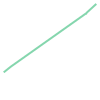

In [33]:
clip_permitted_parking_gdf["geometry"].iloc[10]

In [34]:
clip_permitted_parking_gdf["xy"].iloc[10]

(array('d', [151553.566522, 151557.343824, 151595.48918, 151595.762086, 151596.020949, 151600.93422]),
 array('d', [6576882.61682, 6576885.347901, 6576912.508762, 6576912.716728, 6576912.941932, 6576917.504292]))

In [35]:
clip_permitted_parking_gdf["geom_simple"].iloc[10]

[[151553.566522, 151600.93422], [6576882.61682, 6576917.504292]]

# Plotting on map

# 1. with plotly

In [36]:
# ---> Base map of all permitted parking
fig = go.Figure()

# plot permitted parking
fig.add_trace(
    go.Scatter(
        x=[
            p[0]
            for f in parking_json["features"]
            for p in f["geometry"]["coordinates"] + [[None, None]]
        ],
        y=[
            p[1]
            for f in parking_json["features"]
            for p in f["geometry"]["coordinates"] + [[None, None]]
        ],
        name="permitted_parking",
    )
)


fig.update_layout(autosize=False, width=1200, height=1200)
fig.update_yaxes(scaleanchor="x")


fig.show()

In [37]:
# ---> highlight parking with count of detections

fig_1 = go.Figure()

# #plot permitted parking
# fig_1.add_trace(
#     go.Scatter(
#         x=[
#             p[0]
#             for f in parking_json["features"]
#             for p in f["geometry"]["coordinates"] + [[None, None]]
#         ],
#         y=[
#             p[1]
#             for f in parking_json["features"]
#             for p in f["geometry"]["coordinates"] + [[None, None]]
#         ],
#         name="permitted_parking",
#     )
# )


# closest parking in red
for idx, row in filtered_car_tri_df.iterrows():
    trace = fig_1.add_trace(
        go.Scatter(
            x=[r[0] for r in row["closest_parking_geom"]],
            y=[r[1] for r in row["closest_parking_geom"]],
            name=f"closest_parking_{idx}",
            mode="lines",
            line=dict(width=5),
            hovertext=[row["parking_count"]],
            marker=dict(color=row["parking_count"], colorscale="Greys", showscale=True),
        )
    )


fig_1.update_layout(
    autosize=False,
    width=1200,
    height=1000,
)

fig_1.update_yaxes(scaleanchor="x")

fig_1.show()

In [38]:
fig_1


In [39]:
import folium


In [40]:
bbox_center = [59.312345, 18.066072]
map_1 = folium.Map(location=bbox_center, zoom_start=14, tiles="cartodbpositron")

In [41]:
map_1


In [42]:
import matplotlib.cm as cm

# create red color map with 24 values
red_cmap = cm.get_cmap("Reds", 24)

/tmp/ipykernel_7081/3615908140.py:4: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



In [43]:
permitted_parking_gdf[["geometry", "parking_count"]].explore(
    column="parking_count", cmap="rainbow", m=map_1
).save("parking_heatmap.html")

In [44]:
permitted_parking_gdf.head()


,id,FEATURE_OBJECT_ID,FEATURE_VERSION_ID,EXTENT_NO,VEHICLE,START_TIME,END_TIME,DAY_TYPE,START_WEEKDAY,END_WEEKDAY,...,VF_PLATSER,VF_PLATS_TYP,ADDRESS,RDT_URL,PARKING_RATE,geometry,xy,geom_simple,parking_count,closest_parking_id
FID,,,,,,,,,,,,,,,,,,,,,
44817868,LTFR_P_TILLATEN.44817868,13742836,1,5,fordon,1600.0,800.0,NaN,fredag,NaN,...,NaN,"P Avgift, boende",Lagavägen 2,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (157288.172 6573698.371, 157287.080...","([157288.172185, 157287.080218, 157287.07885, ...","[[157288.172185, 157268.464318], [6573698.3706...",NaN,NaN
44817869,LTFR_P_TILLATEN.44817869,13750219,1,1,rörelsehindrade,NaN,NaN,NaN,NaN,NaN,...,3.0,Reserverad p-plats rörelsehindrad,Heleneborgsgatan 4A,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (152484.638 6578284.974, 152483.502...","([152484.637745, 152483.502093], [6578284.9735...","[[152484.637745, 152483.502093], [6578284.9735...",NaN,NaN
44817870,LTFR_P_TILLATEN.44817870,13751474,1,1,rörelsehindrade,NaN,NaN,NaN,NaN,NaN,...,NaN,Reserverad p-plats rörelsehindrad,Observatoriegatan 20,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 3: 20 kr/tim vardagar 7-19, 15 kr/tim dag...","LINESTRING (152736.834 6580534.810, 152731.302...","([152736.834188, 152731.301517], [6580534.8103...","[[152736.834188, 152731.301517], [6580534.8103...",NaN,NaN
44817871,LTFR_P_TILLATEN.44817871,13718834,1,1,fordon,NaN,NaN,NaN,NaN,NaN,...,NaN,"P Avgift, boende",Letstigen 46 - Letstigen 56,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (158341.006 6573198.838, 158366.896...","([158341.005664, 158366.896226, 158371.440507,...","[[158341.005664, 158374.812032], [6573198.8383...",NaN,NaN
44817872,LTFR_P_TILLATEN.44817872,13718834,1,1,fordon,1600.0,800.0,NaN,tisdag,NaN,...,NaN,"P Avgift, boende",Letstigen 46 - Letstigen 56,https://rdt.transportstyrelsen.se/rdt/AF06_Vie...,"taxa 5: 5 kr/tim vardagar 7-19, Boende: 300 kr...","LINESTRING (158341.006 6573198.838, 158366.896...","([158341.005664, 158366.896226, 158371.440507,...","[[158341.005664, 158374.812032], [6573198.8383...",NaN,NaN


In [45]:
permitted_parking_gdf.dtypes


id                      object
FEATURE_OBJECT_ID        int64
FEATURE_VERSION_ID       int64
EXTENT_NO                int64
VEHICLE                 object
START_TIME             float64
END_TIME               float64
DAY_TYPE                object
START_WEEKDAY           object
END_WEEKDAY            float64
START_WEEK_NO          float64
END_WEEK_NO            float64
ODD_EVEN                object
START_YEAR             float64
END_YEAR               float64
START_MONTH            float64
END_MONTH              float64
START_DAY              float64
END_DAY                float64
MAX_DAYS               float64
MAX_HOURS              float64
MAX_MINUTES            float64
CITATION                object
STREET_NAME             object
CITY_DISTRICT           object
PARKING_DISTRICT        object
OTHER_INFO              object
VF_METER               float64
VF_PLATSER             float64
VF_PLATS_TYP            object
ADDRESS                 object
RDT_URL                 object
PARKING_

<Axes: >

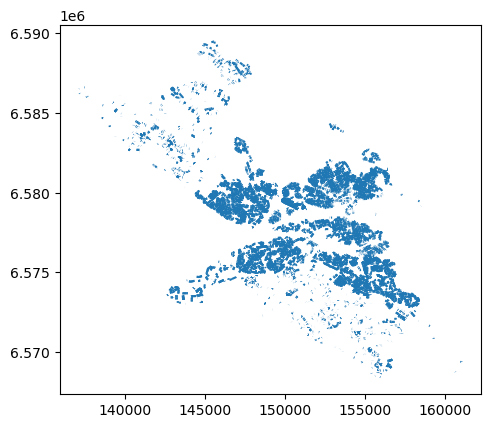

In [46]:
permitted_parking_gdf[["geometry", "parking_count"]].plot()

In [47]:
ls_fg = folium.FeatureGroup(name="permitted-parking")

In [48]:
for linestring in filtered_car_tri_df["closest_parking_geom"]:
    ls_fg.add_child(folium.PolyLine(locations=linestring, color="green"))

map_1.add_child(ls_fg)

In [49]:
folium.LayerControl().add_to(map_1)


In [50]:
map_1
